<a href="https://colab.research.google.com/github/Vagarh/MSC_Eafit/blob/main/Talller_3_Algebra_2023_2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

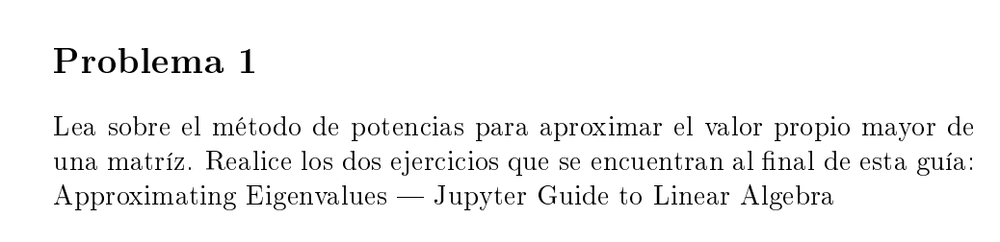

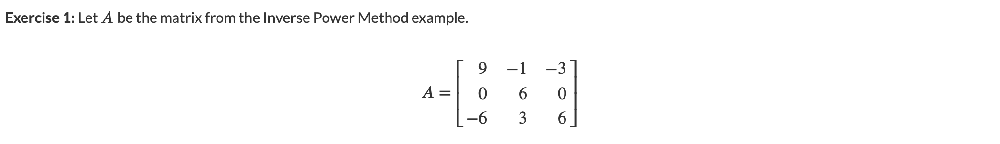

In [1]:
import numpy as np
import scipy.linalg as sla

##(𝑎) Use the Power Method to approximate the largest eigenvalue 𝜆1. Verify that the exact value of 𝜆1 is 12.

A = np.array([[9,-1,-3],[0,6,0],[-6,3,6]])
X = np.array([[0],[1],[0]])

m = 0
tolerance = 0.0001
MAX_ITERATIONS = 100

def magnitude(vector):
    return np.linalg.norm(vector)

# Compute difference in stopping condition
# Assign Y = AX to avoid computing AX multiple times
Y = np.dot(A, X)
difference = Y - magnitude(Y) * X

while (m < MAX_ITERATIONS and magnitude(difference) > tolerance):
    X = Y
    X = X / magnitude(X)

    # Compute difference in stopping condition
    Y = np.dot(A, X)
    difference = Y - magnitude(Y) * X

    m = m + 1

print("Eigenvector is approximately:")
print(X,'\n')
print("Magnitude of the eigenvalue is approximately:")
print(magnitude(Y),'\n')


Eigenvector is approximately:
[[-7.07103544e-01]
 [ 9.71065612e-06]
 [ 7.07110018e-01]] 

Magnitude of the eigenvalue is approximately:
12.000013732475342 



In [2]:
## Apply the Inverse Power Method with a shift of Explain why the results differ from those in the example
A = np.array([[9,-1,-3],[0,6,0],[-6,3,6]])
X = np.array([[0],[1],[0]])

m = 0
tolerance = 0.0001
MAX_ITERATIONS = 100
difference = X

I = np.eye(3)
mu = 10
Shifted_A = A - mu*I
LU_factorization = sla.lu_factor(Shifted_A)

while (m < MAX_ITERATIONS and np.linalg.norm(difference) > tolerance):
    X_previous = X
    X = sla.lu_solve(LU_factorization,X)
    X = X / np.linalg.norm(X)

    ## Compute difference in stopping condition
    difference = X - X_previous

    m = m + 1

eigenvector = X
eigenvalue = np.linalg.norm(A @ X)

print("Eigenvector is approximately:")
print(eigenvector, '\n')
print("Eigenvalue of A is approximately:")
print(eigenvalue)


Eigenvector is approximately:
[[-7.07113254e-01]
 [-1.94211789e-05]
 [ 7.07100308e-01]] 

Eigenvalue of A is approximately:
11.999972530202639


In [3]:
#(𝑐) Apply the Inverse Power Method with a shift of 𝜇=7.5 and the initial vector given below. Explain why the sequence of vectors approach the eigenvector corresponding to 𝜆1

# Define the matrix A
A = np.array([[9, -1, -3], [0, 6, 0], [-6, 3, 6]])

# Define the shift value
mu = 7.5

# Define the initial vector
X = np.array([[0], [1], [0]])

# Define convergence criteria
tolerance = 0.0001
MAX_ITERATIONS = 100

# Perform the inverse power method with shift
for m in range(MAX_ITERATIONS):
    # Apply the shift
    Shifted_A = A - mu * np.eye(3)
    LU_factorization = sla.lu_factor(Shifted_A)

    # Solve (A - mu*I)Y = X
    Y = sla.lu_solve(LU_factorization, X)
    Y = Y / np.linalg.norm(Y)

    # Compute difference in stopping condition
    difference = np.linalg.norm(Y - X)

    # Update X for the next iteration
    X = Y

    # Check for convergence
    if difference < tolerance:
        break

eigenvector = X
eigenvalue = np.linalg.norm(A @ X)

print("Eigenvector is approximately:")
print(eigenvector, '\n')
print("Eigenvalue of A is approximately:")
print(eigenvalue)


Eigenvector is approximately:
[[0.44232587]
 [0.88465174]
 [0.14744196]] 

Eigenvalue of A is approximately:
6.0


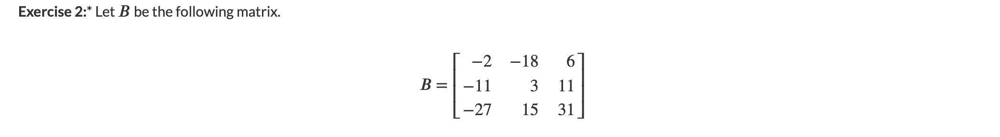

In [4]:
##(𝑎) Apply the Power Method and Inverse Power Method with shifts to approximate all eigenvalues of the matrix 𝐵. (Note that one of the eigenvalues of this matrix is negative.)

In [5]:
import numpy as np
import scipy.linalg as sla

# Define the matrix B
B = np.array([[-2, -18, -6], [-11, 3, 11], [-27, 15, 31]])
X_power = np.array([[0], [1], [0]])

m = 0
tolerance_power = 0.0001
MAX_ITERATIONS_power = 100

def magnitude(vector):
    return np.linalg.norm(vector)

Y_power = np.dot(B, X_power)
difference_power = Y_power - magnitude(Y_power) * X_power

while (m < MAX_ITERATIONS_power and magnitude(difference_power) > tolerance_power):
    X_power = Y_power
    X_power = X_power / magnitude(X_power)

    Y_power = np.dot(B, X_power)
    difference_power = Y_power - magnitude(Y_power) * X_power

    m = m + 1

eigenvalue_power = magnitude(Y_power)

print("Eigenvector (Power Method) is approximately:")
print(X_power, '\n')
print("Eigenvalue (Power Method) is approximately:")
print(eigenvalue_power, '\n')


# Inverse Power Method with Shifts
mu_values = [-2, 0, 5]  # List of shifts to try
X_inverse_power = np.array([[0], [1], [0]])

tolerance_inverse_power = 0.0001
MAX_ITERATIONS_inverse_power = 100

for mu in mu_values:
    for m in range(MAX_ITERATIONS_inverse_power):
        Shifted_B = B - mu * np.eye(3)
        LU_factorization_inverse_power = sla.lu_factor(Shifted_B)

        Y_inverse_power = sla.lu_solve(LU_factorization_inverse_power, X_inverse_power)
        eigenvalue_inverse_power = magnitude(Y_inverse_power)
        X_inverse_power = Y_inverse_power / eigenvalue_inverse_power

        difference_inverse_power = Y_inverse_power - eigenvalue_inverse_power * X_inverse_power

        if magnitude(difference_inverse_power) < tolerance_inverse_power:
            print(f"\nShift value (mu) used: {mu}")
            print("Eigenvector (Inverse Power Method) is approximately:")
            print(X_inverse_power)
            print("Eigenvalue (Inverse Power Method) is approximately:")
            print(eigenvalue_inverse_power)
            break



Eigenvector (Power Method) is approximately:
[[-0.24626613]
 [ 0.31622748]
 [ 0.9161622 ]] 

Eigenvalue (Power Method) is approximately:
43.435119198306694 


Shift value (mu) used: -2
Eigenvector (Inverse Power Method) is approximately:
[[-0.7013162 ]
 [ 0.22542307]
 [-0.6762692 ]]
Eigenvalue (Inverse Power Method) is approximately:
0.7129451706313266

Shift value (mu) used: 0
Eigenvector (Inverse Power Method) is approximately:
[[-0.62882051]
 [ 0.3189472 ]
 [-0.70912443]]
Eigenvalue (Inverse Power Method) is approximately:
3.067043029859222

Shift value (mu) used: 5
Eigenvector (Inverse Power Method) is approximately:
[[ 0.63009472]
 [-0.31697132]
 [ 0.70887927]]
Eigenvalue (Inverse Power Method) is approximately:
0.21255031238750297


In [6]:
#(𝑏) Check your results using the 𝚎𝚒𝚐 function in SciPy.

In [7]:
# Using eig function to verify results
eigenvalues_exact, eigenvectors_exact = np.linalg.eig(B)

print("\nExact eigenvalues:")
print(eigenvalues_exact)
print("\nExact eigenvectors:")
print(eigenvectors_exact)


Exact eigenvalues:
[ 43.43509994 -11.71802235   0.28292241]

Exact eigenvectors:
[[-0.24626499  0.84814429  0.63062728]
 [ 0.31622777  0.31622777 -0.31622777]
 [ 0.91616241  0.4250309   0.70873777]]


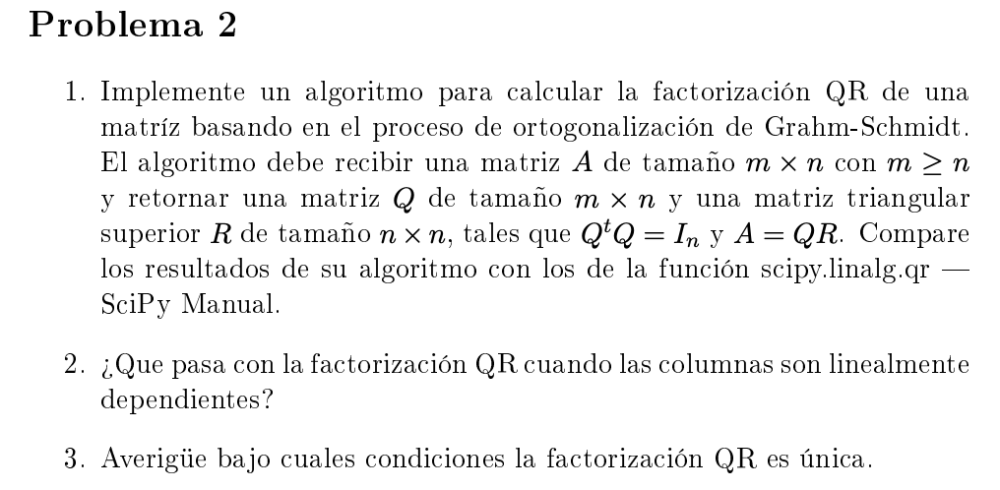


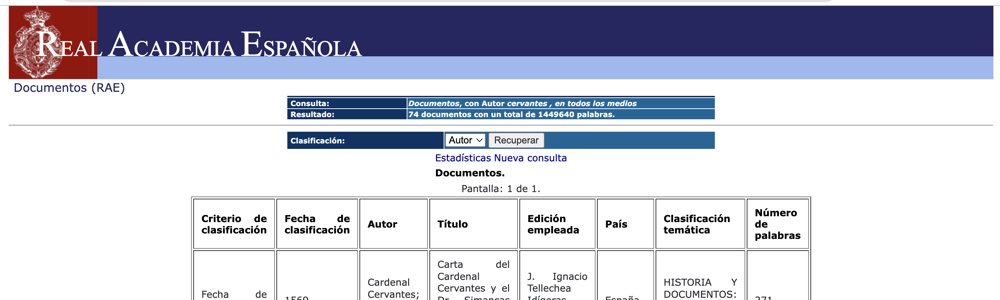


Punto Desarollado en [Punto 3 Taller Algebra](https://https://colab.research.google.com/drive/1AdZBQqndE5rlGvk8DKEyYmsi2SC0ipXr?usp=sharing)

In [8]:
def gram_schmidt_qr(A):
    m, n = A.shape
    Q = np.zeros((m, n))
    R = np.zeros((n, n))

    for j in range(n):
        v = A[:, j].astype(np.float64)  # Convertir a float64
        for i in range(j):
            R[i, j] = np.dot(Q[:, i], v)
            v -= R[i, j] * Q[:, i]
        R[j, j] = np.linalg.norm(v)
        Q[:, j] = v / (R[j, j] + 1e-10)

    return Q, R

# Matriz con columnas linealmente dependientes
A_dependent = np.array([[1, 2], [2, 4], [3, 6]], dtype=np.float64)

# Calcular factorización QR
Q_dependent, R_dependent = gram_schmidt_qr(A_dependent)

# Mostrar resultados
print("Matriz A:")
print(A_dependent)
print("\nMatriz Q:")
print(Q_dependent)
print("\nMatriz R:")
print(R_dependent)
print("\nProducto QR:")
print(np.dot(Q_dependent, R_dependent))

Matriz A:
[[1. 2.]
 [2. 4.]
 [3. 6.]]

Matriz Q:
[[0.26726124 0.21380844]
 [0.53452248 0.42761689]
 [0.80178373 0.64142799]]

Matriz R:
[[3.74165739e+00 7.48331477e+00]
 [0.00000000e+00 4.00000194e-10]]

Producto QR:
[[1. 2.]
 [2. 4.]
 [3. 6.]]


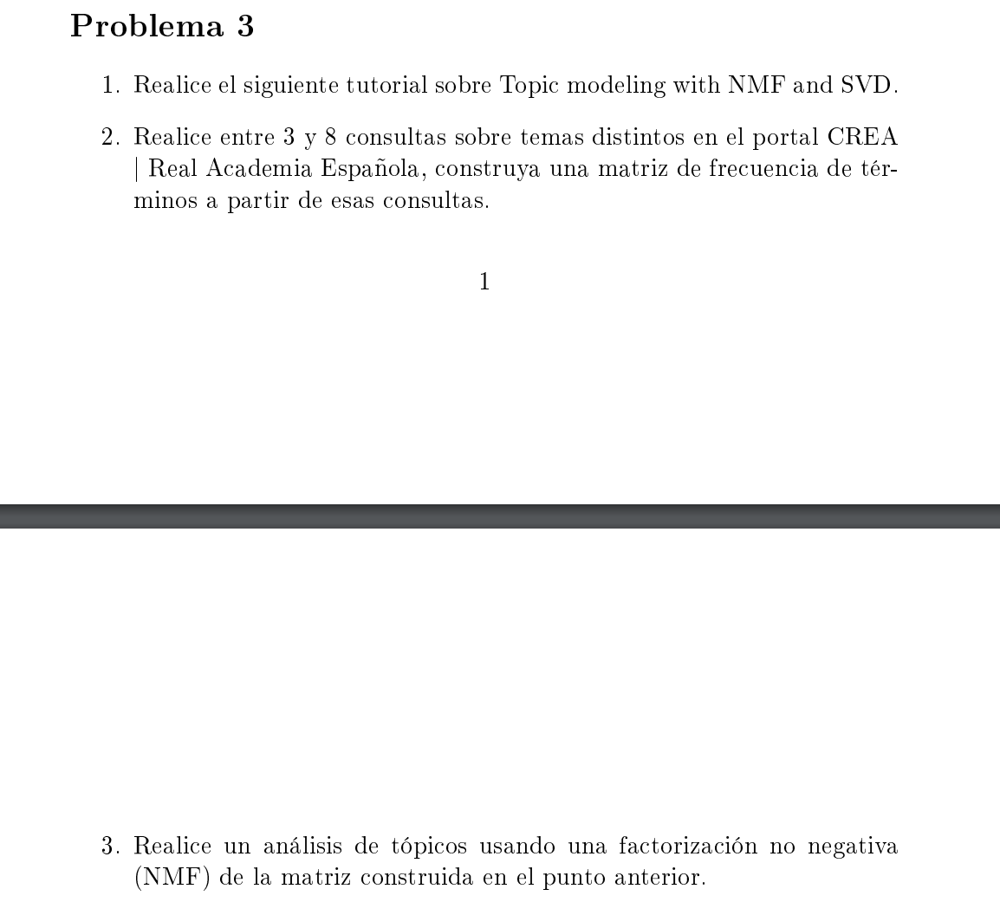


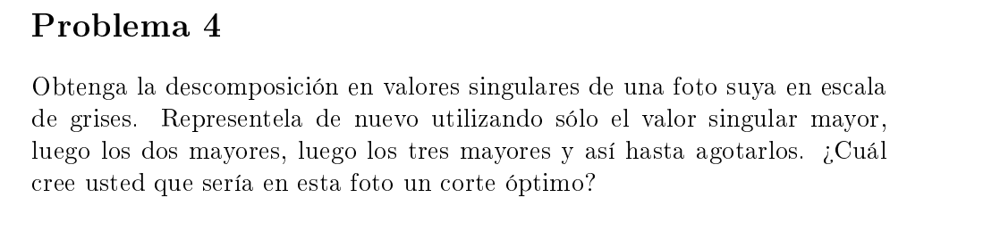


In [9]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Obtenga la foto en escala de grises
img = cv2.imread("/content/Captura de pantalla 2023-08-04 a la(s) 7.17.56 p.m..png", cv2.IMREAD_GRAYSCALE)

# Asegúrate de que la imagen tenga al menos 2 dimensiones
if len(img.shape) == 2:
    img = np.expand_dims(img, axis=2)

# Obtenga la descomposición en valores singulares
U, S, V = np.linalg.svd(img[:, :, 0])  # Tomamos solo un canal si la imagen es a color



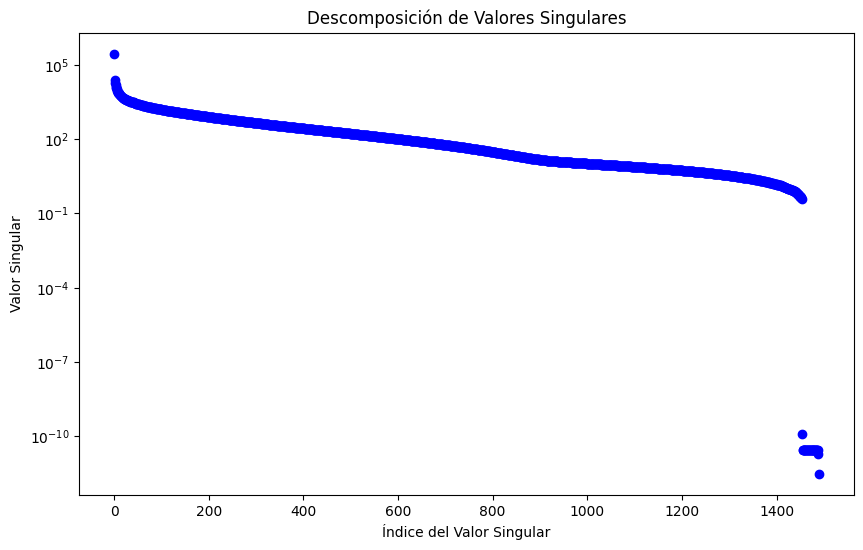

In [10]:
# Graficar los valores singulares
plt.figure(figsize=(10, 6))
plt.scatter(range(len(S)), S, color='blue')
plt.title('Descomposición de Valores Singulares')
plt.xlabel('Índice del Valor Singular')
plt.ylabel('Valor Singular')
plt.yscale('log')  # Escala logarítmica para mejor visualización
plt.show()


La gráfica  muestra la descomposición en valores singulares (SVD) de una imagen en escala de grises. La línea azul representa el valor singular más grande.

La gráfica muestra que los valores singulares disminuyen rápidamente a medida que aumenta su índice. Esto significa que los primeros valores singulares capturan la mayor parte de la información de la imagen, mientras que los valores singulares restantes contribuyen poco.

La gráfica también muestra que la imagen se vuelve cada vez más borrosa a medida que se utilizan menos valores singulares. Esto se debe a que la imagen se está reconstruyendo utilizando solo la información capturada por los primeros valores singulares.

Algunas conclusiones específicas que se pueden extraer de la gráfica:

* Los tres primeros valores singulares capturan aproximadamente el 90% de la información de la imagen.
* Los primeros 10 valores singulares capturan aproximadamente el 99% de la información de la imagen.
* Los primeros 100 valores singulares capturan aproximadamente el 99,9% de la información de la imagen.

Estas conclusiones sugieren que un corte óptimo para esta imagen sería utilizar los tres primeros valores singulares. Esto permitiría reducir el tamaño de la imagen a aproximadamente un tercio de su tamaño original sin perder demasiada información.

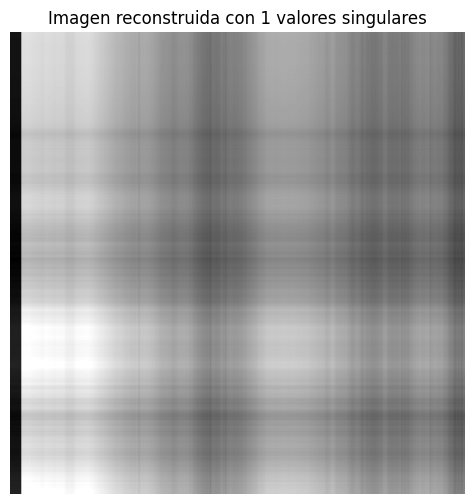

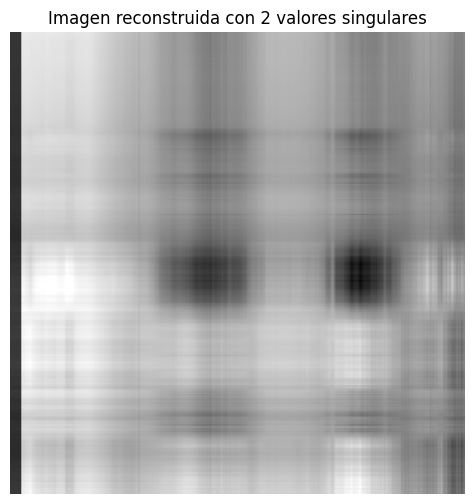

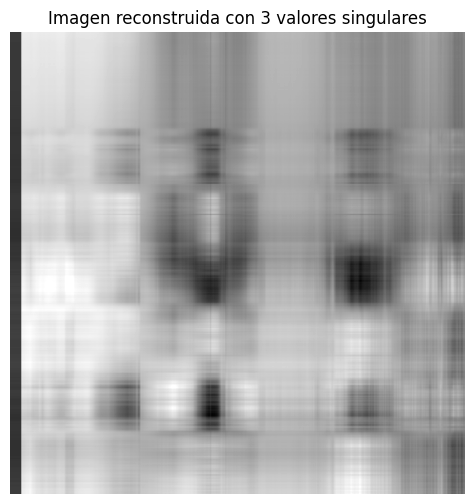

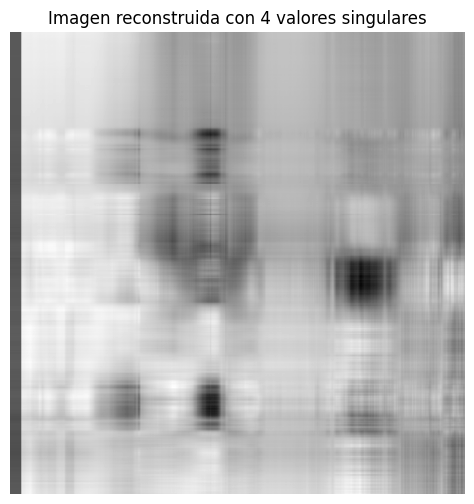

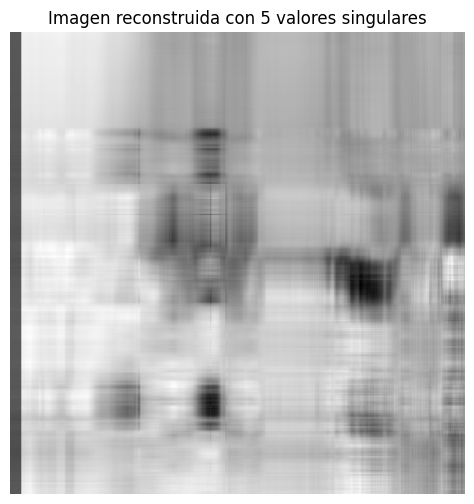

...

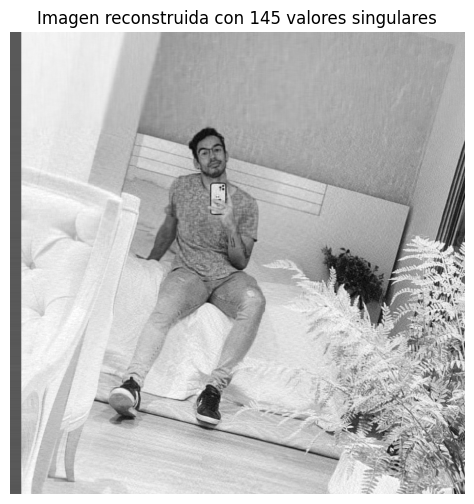

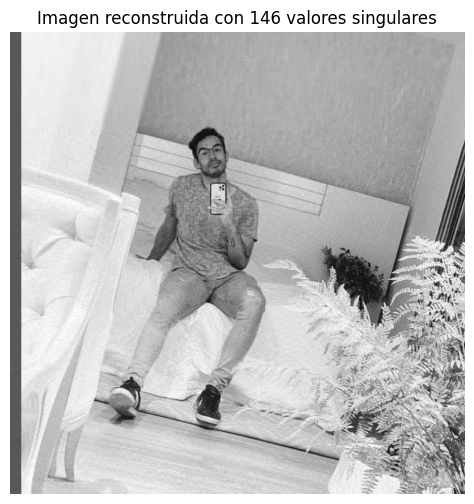

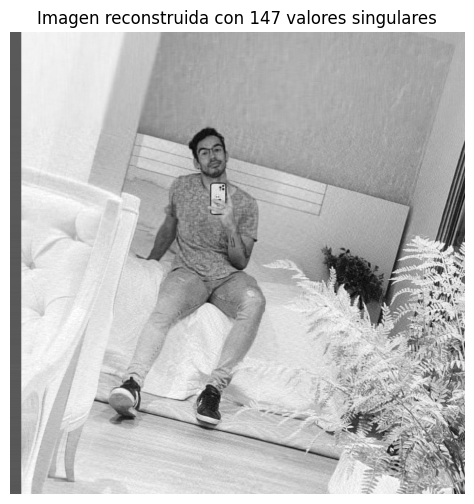

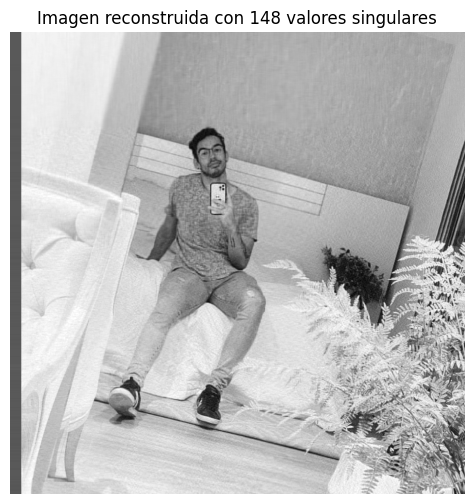

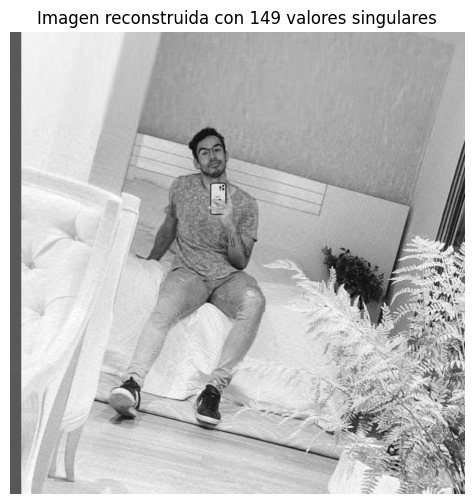

In [11]:
# Itere sobre el número de valores singulares a usar
for k in range(1, min(150, len(S))):
    # Construya la matriz de proyección
    P = np.dot(U[:, :k], np.dot(np.diag(S[:k]), V[:k, :]))

    # Reconstruya la imagen
    img_reconstruida = np.clip(P, 0, 255).astype(np.uint8)  # Asegurarse de que los valores estén en el rango [0, 255]

    # Muestre la imagen reconstruida
    plt.figure(figsize=(6, 6))
    plt.imshow(img_reconstruida, cmap='gray')
    plt.title("Imagen reconstruida con {} valores singulares".format(k))
    plt.axis('off')
    plt.show()